In [1]:
import sys
sys.path.append('../..')
import PINNFramework as pf

import os
import h5py
import torch
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
from celluloid import Camera
from IPython.display import HTML

from datasets import *

%matplotlib inline

Was not able to import Horovod. Thus Horovod support is not enabled


In [ ]:
%run pennes_hpm.py --name 'default' --num_t 1000 --path_data "/bigdata/hplsim/aipp/Maksim/data/" --use_wandb 1

## Creating dataset

In [2]:
path_data = "/bigdata/hplsim/aipp/Maksim/data/"
batch_size = 512
cold_bolus = False # if cold bolus data is taken (False by default)

In [3]:
# Dataset parameters

num_t = 1000 # up to 3000, where 3000 corresponds to ~60s

data_info = {
    "path_data": path_data, 
    "num_t": num_t,
    "t_step": 5, # each 't_step'-th data frame will be taken for the dataset
    "pix_step": 1, # each 'pix_step'-th pixel will be taken for the dataset
    "num_x": 640,
    "num_y": 480,
    "t_min": load_frame(path_data, 0)[1].item(),
    "t_max": load_frame(path_data, num_t)[1].item(),
    "spat_res": 0.3 # spatial resolution (distance between pixels in [mm])
}

In [4]:
# Empirically found segmentation parameters for UKD data
segm_params = [32.4, 5, 5] if not cold_bolus else [31.0, 15, 15]
# Use half of the available data points 0.5*(#time points * #grid points * segm.coef)
num_batches = int(((data_info['num_t']*640*480*0.25)*0.5)//batch_size)

In [5]:
ic_dataset = InitialConditionDataset(  
    data_info, 512, num_batches, segm_params)
initial_condition = pf.InitialCondition(dataset=ic_dataset, name="Initial Condition", weight=1.)

print('system boundaries: \n X ∈ [{:.1f}, {:.1f}] mm \n Y ∈ [{:.1f}, {:.1f}] mm \n T ∈ [{:.1f}, {:.1f}] s'.format(ic_dataset.low_bound[0], ic_dataset.up_bound[0], ic_dataset.low_bound[1], ic_dataset.up_bound[1], ic_dataset.low_bound[2], ic_dataset.up_bound[2]))

system boundaries: 
 X ∈ [46.5, 146.7] mm 
 Y ∈ [21.9, 121.5] mm 
 T ∈ [0.0, 19.2] s


In [6]:
# I further substitute data's actual boundaries with the global boundaries of the system. 
# Global boundaries are taken for the reason to make a model independent wrt dataset parameters.
# I found it more convenient for further comparison of models.

low_bound = torch.Tensor([49.8000, 22.2000,  0.0]) if not cold_bolus else torch.Tensor([34.2000, 4.5000,  0.0])
up_bound = torch.Tensor([148.5000, 120.6000, 60.0]) if not cold_bolus else torch.Tensor([164.4000, 112.2000,  50.0])

print('system boundaries after update: \n X ∈ [{:.1f}, {:.1f}] mm \n Y ∈ [{:.1f}, {:.1f}] mm \n T ∈ [{:.1f}, {:.1f}] s'.format(low_bound[0], up_bound[0], low_bound[1], up_bound[1], low_bound[2], up_bound[2]))

system boundaries after update: 
 X ∈ [49.8, 148.5] mm 
 Y ∈ [22.2, 120.6] mm 
 T ∈ [0.0, 60.0] s


## Initialize models

In [7]:
# Learning parameters
lr = 1e-5
use_gpu = True
weight = 1.
weight_hpm = 1.
# Model parameters
hidden_size=500
num_hidden=3
convection=True
linear_u=True
cold_bolus=False

config = {'convection': 1, 'linear_u': 1, 'heat_source':1}    

In [8]:
pde_dataset = PDEDataset(
    data_info,
    batch_size,
    num_batches,
    segm_params) 

model = pf.models.MLP(input_size=3,
                      output_size=1,
                      hidden_size=hidden_size,
                      num_hidden=num_hidden,
                      lb=low_bound,
                      ub=up_bound)

hs_net = pf.models.MLP(input_size=3,
                  output_size=1,
                  hidden_size=100,
                  num_hidden=1,
                  lb=low_bound,
                  ub=up_bound)

hpm_model = pf.models.PennesHPM(config, hs_net = hs_net)
hpm_loss = pf.HPMLoss.HPMLoss(dataset=pde_dataset, hpm_input=derivatives, hpm_model=hpm_model, name="Pennes Equation", weight=weight_hpm)

pinn = pf.PINN(
        model,
        input_dimension=8,
        output_dimension=1,
        pde_loss=hpm_loss,
        initial_condition=initial_condition,
        boundary_condition=None,
        use_gpu=use_gpu,
        use_horovod=False)

In [9]:
pinn_path = "/bigdata/hplsim/aipp/Maksim/default_best_model_pinn.pt"
hpm_path = "/bigdata/hplsim/aipp/Maksim/default_best_model_hpm.pt"

model.load_state_dict(torch.load(pinn_path))
hpm_model.load_state_dict(torch.load(hpm_path))

<All keys matched successfully>

In [10]:
mask = segmentation(data_info["path_data"], 0, data_info["num_x"], data_info["num_y"], segm_params)

## Functions for visualization

In [11]:
def get_2d_grid(num_x, num_y):
    """
    Create a vector with all postions of a 2D grid (nx X ny )
    """
    x_values = np.arange(0, num_x, 1)
    y_values = np.arange(0, num_y, 1)

    x_grid, y_grid = np.meshgrid(x_values, y_values)

    pos_x = x_grid.reshape(-1)
    pos_y = y_grid.reshape(-1)

    return pos_x, pos_y 

def get_input(t_point, path_data, num_x, num_y, spat_res):
    """
    get the input for a specifiy point t 
    this function returns a list of grid points appended with time t
    """
    hf = h5py.File(path_data + str(t_point) + '.h5', 'r')
    t_values = np.array(hf['timing'][0])
    hf.close()

    pos_x, pos_y = get_2d_grid(num_x, num_y)

    size = pos_x.shape[0]
    pos_t = np.zeros(size) + t_values

    val_x = pos_x*spat_res
    val_y = pos_y*spat_res

    return val_x, val_y, pos_t, pos_x, pos_y

In [61]:
def get_hpm(t_max=20, n_snapshots=40):
    """
    Calculate prediction of an HPM model for multiple time points and store them in a list.
    Args:
        t_max (float): latest time point of interest.
        n_snapshots (int): number of snapshots to make.
    Returns:
        a list with 'n_snapshots' predictions of an HPM model made in the time interval [0, 't_max']
    """
    snapshots = []
    for t_point in tqdm(range(0,int(t_max/0.02),int(t_max/0.02)//n_snapshots)):
        x_values,y_values,t_values,x_indices,y_indices= torch.tensor(get_input(t_point, data_info['path_data'], data_info['num_x'], data_info['num_y'], data_info['spat_res']))
        X = torch.stack([x_values, y_values, t_values], 1).cuda().float()
        image_hpm = np.zeros(0)
        for i in range((480*640)//512):
            X_ = X[i*512:(i+1)*512,:]
            X_.requires_grad = True
            prediction_u = model(X_)
            hpm_input = derivatives(X_, prediction_u)
            input = hpm_input[:, :-1]
            image_hpm = np.append(image_hpm, hpm_model(hpm_input).cpu().detach().numpy())
        snapshots.append(image_hpm.reshape(480,640))
    return snapshots

def get_u_pinn(t_max=20, n_snapshots=40):
    """
    Calculate prediction of an interpolation model for multiple time points and store them in a list.
    Args:
        t_max (float): latest time point of interest.
        n_snapshots (int): number of snapshots to make.
    Returns:
        a list with 'n_snapshots' predictions of a model made in the time interval [0, 't_max']
    """
    snapshots = []
    for t_point in tqdm(range(0,int(t_max/0.02),int(t_max/0.02)//n_snapshots)):
        x_values,y_values,t_values,x_indices,y_indices= torch.tensor(get_input(t_point, data_info['path_data'], data_info['num_x'], data_info['num_y'], data_info['spat_res']))
        X = torch.stack([x_values, y_values, t_values], 1).cuda().float()
        image = model(X).cpu().detach().numpy().reshape(-1)
        snapshots.append(image.reshape(480,640))
    return snapshots

def get_u_data(t_max=20, n_snapshots=40):
    """
    Get data frame for multiple time points and store them in a list.
    Args:
        t_max (float): latest time point of interest.
        n_snapshots (int): number of snapshots to make.
    Returns:
        a list with 'n_snapshots' data frames in the time interval [0, 't_max']
    """
    snapshots = []
    for t_point in tqdm(range(0,int(t_max/0.02),int(t_max/0.02)//n_snapshots)):
        image = load_frame(data_info['path_data'], t_point)[0]
        snapshots.append(image.reshape(640,480).T)
    return snapshots  

def get_dudt_pinn(t_max=20, n_snapshots=40):
    """
    Get du/dt calculated as derivative of the interpolation network
        for multiple time points and store them in a list.
    Args:
        t_max (float): latest time point of interest.
        n_snapshots (int): number of snapshots to make.
    Returns:
        a list with 'n_snapshots' du/dt in the time interval [0, 't_max']
    """
    snapshots = []
    for t_point in tqdm(range(0,int(t_max/0.02),int(t_max/0.02)//n_snapshots)):
        x_values,y_values,t_values,x_indices,y_indices= torch.tensor(get_input(t_point, data_info['path_data'], data_info['num_x'], data_info['num_y'], data_info['spat_res']))
        X = torch.stack([x_values, y_values, t_values], 1).cuda().float()
        image = np.zeros(0)
        for i in range((480*640)//512):
            X_ = X[i*512:(i+1)*512,:]
            X_.requires_grad = True
            prediction_u = model(X_)
            hpm_input = derivatives(X_, prediction_u)
            image = np.append(image, hpm_input[:, -1].cpu().detach().numpy())
        snapshots.append(image.reshape(480,640))
    return snapshots


In [22]:
%matplotlib inline
def animate(snapshots, vmin = None, vmax = None):
    vmin = vmin if vmin is not None else snapshots[0].min() 
    vmax = vmax if vmax is not None else snapshots[0].max() 
    fig, ax = plt.subplots(figsize = [10,10]);
    plt.close() 
    cam = Camera(fig);
    for snapshot in snapshots
        ax.imshow(snapshot, vmin = vmin, vmax = vmax)
        cam.snap()
    return cam.animate()

## Visualize

### prediction of PINN model

In [20]:
u = get_u_pinn()

100%|██████████| 40/40 [00:08<00:00,  4.72it/s]


In [23]:
ani = animate([i*mask.T for i in u], 29, 35)
HTML(ani.to_jshtml())  

### time derivative of the prediction of PINN model

In [62]:
dudt_pinn = get_dudt_pinn()

100%|██████████| 40/40 [01:23<00:00,  2.09s/it]


In [64]:
ani = animate([i*mask.T for i in dudt_pinn], -0.1, 0.1)
HTML(ani.to_jshtml())  

### prediction of HPM model

In [17]:
dudt_hpm = get_hpm()

100%|██████████| 40/40 [01:31<00:00,  2.29s/it]


In [25]:
ani = animate([i*mask.T for i in dudt_hpm], -0.1, 0.1)
HTML(ani.to_jshtml())  

## Model learned parameters

Model: $\frac{du}{dt} = a_{conv} \cdot \Delta u + a_{linear \: u_b} \cdot (u - u_{blood}) + a_{linear \: u_w} + heat \: source$ 

$a_{conv}, a_{linear \: u_b}, a_{linear \: u_w} \in \mathbb{R}^{640 \times 480}$, heat source is a FC neural network.

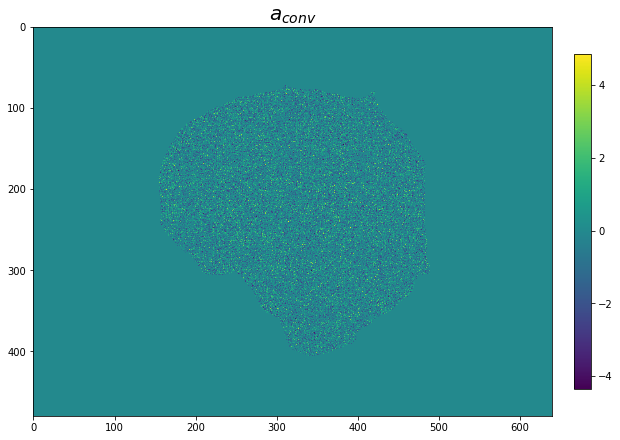

In [57]:
# a_conv
plt.figure(figsize=[10,10])
im = plt.imshow(hpm_model.a_conv.cpu().detach().T*mask.T)
plt.colorbar(im, fraction=0.03, pad=0.04)
plt.title('$a_{conv}$', fontsize=20);

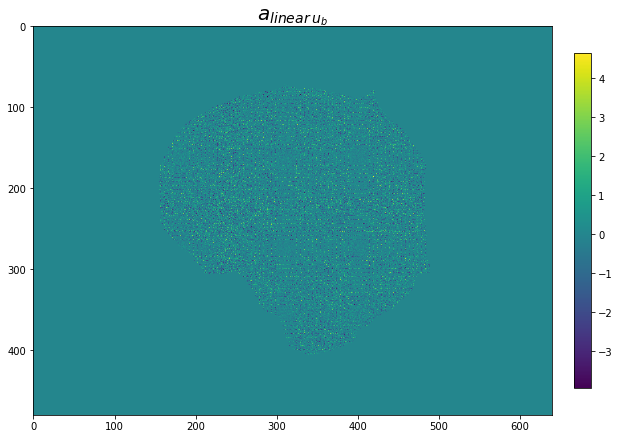

In [60]:
# a_linear_u_w
plt.figure(figsize=[10,10])
im = plt.imshow(hpm_model.a_linear_u_w.cpu().detach().T*mask.T)
plt.colorbar(im, fraction=0.03, pad=0.04)
plt.title('$a_{linear \: u_b}$', fontsize=20);

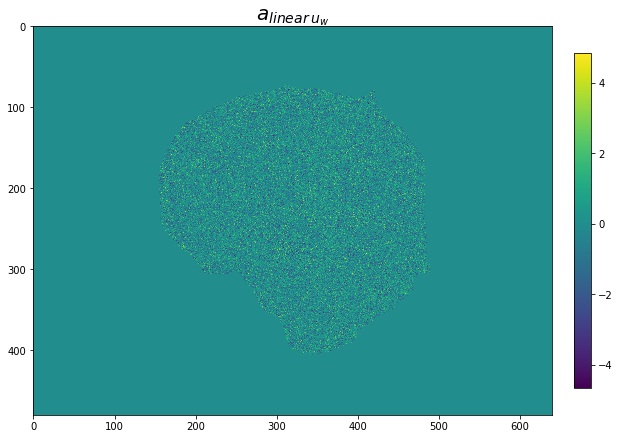

In [59]:
# a_linear_u_b
plt.figure(figsize=[10,10])
im = plt.imshow(hpm_model.a_linear_u_b.cpu().detach().T*mask.T)
plt.colorbar(im, fraction=0.03, pad=0.04)
plt.title('$a_{linear \: u_w}$', fontsize=20);